In [1]:
pwd

'/mnt/qtim/registration/notebooks'

In [4]:
import sys
sys.path.append('../src')
import data, utils

In [2]:
from __future__ import annotations
import pandas as pd
from collections import defaultdict
from copy import deepcopy
from pathlib import Path
from importlib import reload
import matplotlib.pyplot as plt; plt.style.use('seaborn-pastel'); plt.set_cmap('bone')
import matplotlib.image as mpimg
import neurite as ne
import numpy as np
import os; os.environ['VXM_BACKEND'] = 'pytorch'
from time import perf_counter
import torch
import torchvision
from tqdm import tqdm 
import random
import voxelmorph as vm
print(sys.version)
print('numpy version', np.__version__)
print('torch version', torch.__version__)
print(f'voxelmorph using {vm.py.utils.get_backend()} backend')

2022-07-11 17:02:12.485808: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/nvidia/lib:/usr/local/nvidia/lib64
2022-07-11 17:02:12.485837: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.


3.8.12 (default, Oct 12 2021, 13:49:34) 
[GCC 7.5.0]
numpy version 1.21.2
torch version 1.11.0
voxelmorph using pytorch backend


<Figure size 432x288 with 0 Axes>

In [5]:
base = Path('/mnt/qtim/data/registration/v3.2-midslice') 

In [51]:
reload(data)

<module 'data' from '/mnt/qtim/registration/notebooks/../src/data.py'>

In [61]:
use_256 = False
idrid_train_ds, idrid_val_ds, idrid_test_ds = data.make_idrid_datasets(use_256=use_256)
isbi_train_ds, isbi_val_ds, isbi_test_ds = data.make_isbi_datasets(use_256=use_256)
feta_train_ds, feta_val_ds, feta_test_ds = data.make_feta_datasets(use_256=use_256)
wbc_train_ds, wbc_val_ds, wbc_test_ds = data.make_wbc_datasets(use_256=use_256)
t1mix_train_ds, t1mix_val_ds, t1mix_test_ds = data.make_t1mix_datasets(use_256=use_256)
oasis_train_ds, oasis_val_ds, oasis_test_ds = data.make_oasis_datasets(use_256=use_256)
i2cvb_test_ds = data.make_i2cvb_datasets(use_256=use_256, combine=True)
spineweb_test_ds = data.make_spineweb_datasets(use_256=use_256, combine=True)
braindev_test_ds = data.make_braindev_datasets(use_256=use_256, combine=True)
msd_test_ds = data.make_msd_datasets(use_256=use_256, combine=True)

print(*map(len, [msd_train_ds, idrid_train_ds, t1mix_train_ds, isbi_train_ds, oasis_train_ds, feta_train_ds, i2cvb_train_ds, spineweb_train_ds, braindev_train_ds, wbc_train_ds]))

12 32 212 18 248 48 11 9 12 180


In [62]:
single_train_1 = deepcopy(wbc_train_ds)
single_val_1 = deepcopy(wbc_val_ds)
single_test_1 = deepcopy(wbc_test_ds)

single_train_2 = deepcopy(t1mix_train_ds)
single_val_2 = deepcopy(t1mix_val_ds)
single_test_2 = deepcopy(t1mix_test_ds)

single_train_3 = deepcopy(oasis_train_ds)
single_val_3 = deepcopy(oasis_val_ds)
single_test_3 = deepcopy(oasis_test_ds)

t1mix_train_ds.set_indexer(list(range(90)))
wbc_train_ds.set_indexer(list(range(90)))
multi_train_1 = data.MultiRegistrationDataset([idrid_train_ds, isbi_train_ds, wbc_train_ds, t1mix_train_ds])

t1mix_train_ds.set_indexer(list(range(50)))
oasis_train_ds.set_indexer(list(range(50)))
wbc_train_ds.set_indexer(list(range(50)))
multi_train_2 = data.MultiRegistrationDataset([idrid_train_ds, isbi_train_ds, wbc_train_ds, t1mix_train_ds, oasis_train_ds, feta_train_ds])

t1mix_val_ds.set_indexer(list(range(30)))
wbc_val_ds.set_indexer(list(range(30)))
multi_val_1 = data.MultiRegistrationDataset([idrid_val_ds, t1mix_val_ds, wbc_val_ds, isbi_val_ds])

t1mix_val_ds.set_indexer(list(range(15)))
oasis_val_ds.set_indexer(list(range(15)))
wbc_val_ds.set_indexer(list(range(15)))
multi_val_2 = data.MultiRegistrationDataset([idrid_val_ds, t1mix_val_ds, wbc_val_ds, isbi_val_ds, oasis_val_ds, feta_val_ds])

t1mix_test_ds.set_indexer(list(range(30)))
wbc_test_ds.set_indexer(list(range(30))) 
multi_test_1 = data.MultiRegistrationDataset([idrid_test_ds, t1mix_test_ds, wbc_test_ds, isbi_test_ds])

t1mix_test_ds.set_indexer(list(range(15)))
oasis_test_ds.set_indexer(list(range(15))) 
wbc_test_ds.set_indexer(list(range(15))) 
multi_test_2 = data.MultiRegistrationDataset([idrid_test_ds, t1mix_test_ds, wbc_test_ds, isbi_test_ds, oasis_test_ds, feta_test_ds])

In [63]:
print(len(single_train_1), len(single_train_2), len(single_train_3), len(multi_train_1), len(multi_train_2))
print(len(single_val_1), len(single_val_2), len(single_val_3), len(multi_val_1), len(multi_val_2))
print(len(single_test_1), len(single_test_2), len(single_test_3),len(multi_test_1), len(multi_test_2))

180 212 248 230 248
60 71 83 77 78
60 71 83 77 78


In [68]:
batch_size=16
train_dl_1 = data.make_dataloader(single_train_1, batch_size=batch_size, shuffle=True)
train_dl_2 = data.make_dataloader(single_train_2, batch_size=batch_size, shuffle=True)
train_dl_3 = data.make_dataloader(single_train_3, batch_size=batch_size, shuffle=True)
train_dl_4 = data.make_dataloader(multi_train_1, batch_size=batch_size, shuffle=True)
train_dl_5 = data.make_dataloader(multi_train_2, batch_size=batch_size, shuffle=True)

val_dl_1 = data.make_dataloader(single_val_1, batch_size=batch_size)
val_dl_2 = data.make_dataloader(single_val_2, batch_size=batch_size)
val_dl_3 = data.make_dataloader(single_val_3, batch_size=batch_size)
val_dl_4 = data.make_dataloader(multi_val_1, batch_size=batch_size)
val_dl_5 = data.make_dataloader(multi_val_2, batch_size=batch_size)

test_dl_1 = data.make_dataloader(single_test_1, batch_size=batch_size)
test_dl_2 = data.make_dataloader(single_test_2, batch_size=batch_size)
test_dl_3 = data.make_dataloader(single_test_3, batch_size=batch_size)
test_dl_4 = data.make_dataloader(multi_test_1, batch_size=batch_size)
test_dl_5 = data.make_dataloader(multi_test_2, batch_size=batch_size)

ext_dl_1 = data.make_dataloader(i2cvb_test_ds, batch_size=1)
ext_dl_2 = data.make_dataloader(spineweb_test_ds, batch_size=1)
ext_dl_3 = data.make_dataloader(braindev_test_ds, batch_size=1)
ext_dl_4 = data.make_dataloader(msd_test_ds, batch_size=1)

In [69]:
class Model(torch.nn.Module):
    def __init__(
        self,
        image_size: tuple[int, int] | tuple[int, int, int],
        input_channels: int = 2,
    ):
        super().__init__()
        self.image_size = image_size
        self.input_channels= input_channels
        self.ndim = len(image_size)
        self.unet = vm.networks.Unet(inshape=image_size, infeats=input_channels)
        self.flow = getattr(torch.nn, f'Conv{self.ndim}d')(16, 2, 3, padding=1)
        self.spatial_transformer = vm.layers.SpatialTransformer(image_size)
        
    def transform(self, x: torch.Tensor, warp: torch.Tensor, mode='bilinear') -> torch.Tensor:
        self.spatial_transformer.mode = mode
        x = self.spatial_transformer(x, warp)
        return x
    
    def forward(self, x: torch.Tensor) -> torch.Tensor:
        # img, seg = x[:2], x[
        displacement = self.flow(self.unet(x))
        moving_image = x[:, 0].unsqueeze(1)
        moved_image = self.transform(moving_image, displacement)
        return moved_image, displacement

In [70]:
inshape = (128, 128)
# inshape = (256, 256)
infeats = 2
model1 = Model(inshape).to('cuda')
model2 = Model(inshape).to('cuda')
model3 = Model(inshape).to('cuda')
model4 = Model(inshape).to('cuda')
model5 = Model(inshape).to('cuda')

/opt/conda/lib/python3.8/site-packages/torch/functional.py:568: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  /opt/conda/conda-bld/pytorch_1646755903507/work/aten/src/ATen/native/TensorShape.cpp:2228.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


In [71]:
mse = vm.losses.MSE()
grad = vm.losses.Grad('l2')

def loss_func(moving, fixed, displacement, weight=0.05):
    mse_loss = mse.loss(fixed, moving)
    grad_loss = grad.loss(displacement)
    return mse_loss + weight * grad_loss

def dice_func(a, b, eps=1e-8):
            intersection = 2 * torch.logical_and(a, b).sum()
            union = a.sum() + b.sum() + eps
            return intersection / union

In [73]:
opt1 = torch.optim.Adam(model1.parameters(), lr=1e-3)
opt2 = torch.optim.Adam(model2.parameters(), lr=1e-3)
opt3 = torch.optim.Adam(model3.parameters(), lr=1e-3)
opt4 = torch.optim.Adam(model4.parameters(), lr=1e-3)
opt5 = torch.optim.Adam(model5.parameters(), lr=1e-3)

In [74]:
def iterate(
    model,
    loader,
    optimizer=None,
    training: bool = True,
):
    average_loss = 0
    average_dice = 0
    if training:
        model.train()
    else:
        model.eval()
    # for i, images in tqdm(enumerate(loader)):
    for i, (images, segmentations) in enumerate(loader):
        images = images.to('cuda')
        segmentations = segmentations.to('cuda')
        moved_images, displacements = model(images)
        moved_segmentations = model.transform(segmentations[:, 0].unsqueeze(1), displacements, mode='nearest')
        fixed_images = images[:, 1].unsqueeze(1)
        fixed_segmentations = segmentations[:, 1].unsqueeze(1)
        loss = loss_func(moved_images, fixed_images, displacements)
        dice = dice_func(moved_segmentations, fixed_segmentations)
        if training:
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
        average_loss += loss.detach().item()
        average_dice += dice.detach().item()
    average_loss /= len(loader.dataset)
    average_dice /= len(loader.dataset)
    return average_loss, average_dice
    
def train(
    model,
    optimizer,
    train_loader,
    val_loader,
    epochs: int = 10,
    verbose: bool = True,
):
    history = defaultdict(list)
    for i in tqdm(range(epochs)):
        train_loss, train_dice = iterate(model, train_loader, optimizer)
        history[f'train_loss'].append(train_loss)
        history[f'train_dice'].append(train_dice)
        val_loss, val_dice = iterate(model, val_loader, training=False)
        history[f'val_loss'].append(val_loss)
        history[f'val_dice'].append(val_dice)
        if verbose and (i+1) % 500 == 0: print(f'epoch {i} finished')
    return history

In [ ]:
epochs = 2000
multi_epochs = 8000
history_1 = train(model1, opt1, train_dl_1, val_dl_1, epochs=epochs)
history_2 = train(model2, opt2, train_dl_2, val_dl_2, epochs=epochs)
history_3 = train(model3, opt3, train_dl_3, val_dl_3, epochs=epochs)
history_4 = train(model4, opt4, train_dl_4, val_dl_4, epochs=multi_epochs)
history_5 = train(model5, opt5, train_dl_5, val_dl_5, epochs=multi_epochs)

  0%|                                                                                            | 1/2000 [00:25<14:23:15, 25.91s/it]

epoch 0 finished


 25%|██████████████████████▎                                                                  | 501/2000 [1:15:19<3:45:07,  9.01s/it]

epoch 500 finished


 50%|████████████████████████████████████████████                                            | 1001/2000 [2:40:21<3:34:05, 12.86s/it]

epoch 1000 finished


 75%|██████████████████████████████████████████████████████████████████                      | 1501/2000 [4:18:42<1:45:03, 12.63s/it]

epoch 1500 finished


  0%|                                                                                            | 1/2000 [00:32<17:46:18, 32.01s/it]

epoch 0 finished


 25%|██████████████████████▎                                                                  | 501/2000 [2:31:34<8:29:55, 20.41s/it]

epoch 500 finished


 50%|████████████████████████████████████████████                                            | 1001/2000 [5:11:19<5:10:37, 18.66s/it]

epoch 1000 finished


 75%|██████████████████████████████████████████████████████████████████                      | 1501/2000 [7:45:44<2:36:00, 18.76s/it]

epoch 1500 finished


  0%|▏                                                                                                                                                                                                                                                                                    | 1/2000 [00:42<23:37:30, 42.55s/it]

epoch 0 finished


 25%|████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                                             | 501/2000 [3:26:41<9:24:22, 22.59s/it]

epoch 500 finished


 49%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                            | 975/2000 [6:33:41<7:45:37, 27.26s/it]

In [ ]:
from scipy import signal
k = 32
window = signal.windows.triang(k)
avg = lambda sig: signal.convolve(sig, window, mode='valid')
fs=32
lw=4
fig, ax = plt.subplots(ncols=1, nrows=5, figsize=(24, 24))
ax[0].plot(avg(history_1['train_loss']), label='train_1',  lw=lw, c='C0')
ax[0].plot(avg(history_1['val_loss']), label='val_1', ls='--', lw=lw, c='C0')
ax[1].plot(avg(history_2['train_loss']), label='train_2',  lw=lw, c='C1')
ax[1].plot(avg(history_2['val_loss']), label='val_2', ls='--', lw=lw, c='C1')
ax[2].plot(avg(history_3['train_loss']), label='train_3',  lw=lw, c='C2')
ax[2].plot(avg(history_3['val_loss']), label='val_3', ls='--', lw=lw, c='C2')
ax[3].plot(avg(history_4['train_loss']), label='train_4',  lw=lw, c='C3')
ax[3].plot(avg(history_4['val_loss']), label='val_4', ls='--', lw=lw, c='C3')
ax[4].plot(avg(history_5['train_loss']), label='train_5',  lw=lw, c='C3')
ax[4].plot(avg(history_5['val_loss']), label='val_5', ls='--', lw=lw, c='C3')
ax[0].tick_params(axis='both', which='major', labelsize=fs, pad=15)
ax[1].tick_params(axis='both', which='major', labelsize=fs, pad=15)
ax[2].tick_params(axis='both', which='major', labelsize=fs, pad=15)
ax[3].tick_params(axis='both', which='major', labelsize=fs, pad=15)
ax[4].tick_params(axis='both', which='major', labelsize=fs, pad=15)
ax[0].set_title('single model 1')
ax[1].set_title('single model 2')
ax[2].set_title('single model 3')
ax[3].set_title('multi model 1')
ax[4].set_title('multi model 2')
# ax[0,0].set_ylim(0.23, 0.27)
ax[0].set_xlabel('epochs', fontsize=fs)
ax[1].set_xlabel('epochs', fontsize=fs)
ax[2].set_xlabel('epochs', fontsize=fs)
ax[3].set_xlabel('epochs', fontsize=fs)
ax[4].set_xlabel('epochs', fontsize=fs)
ax[0].set_ylabel('loss', fontsize=fs)
ax[1].set_ylabel('loss', fontsize=fs)
ax[3].set_ylabel('loss', fontsize=fs)
ax[4].set_ylabel('loss', fontsize=fs)
ax[5].set_ylabel('loss', fontsize=fs)
plt.tight_layout(w_pad=4)
# plt.legend(fontsize=fs, ncol=3, bbox_to_anchor=(0.60, -0.30))
# plt.savefig('figures/midslice-loss.svg')
plt.show()

In [ ]:
from scipy import signal
k = 32
window = signal.windows.triang(k)
avg = lambda sig: signal.convolve(sig, window, mode='valid')
fs=32
lw=4
fig, ax = plt.subplots(ncols=1, nrows=5, figsize=(24, 24))
ax[0].plot(avg(history_1['train_dice']), label='train_1',  lw=lw, c='C0')
ax[0].plot(avg(history_1['val_dice']), label='val_1', ls='--', lw=lw, c='C0')
ax[1].plot(avg(history_2['train_dice']), label='train_2',  lw=lw, c='C1')
ax[1].plot(avg(history_2['val_dice']), label='val_2', ls='--', lw=lw, c='C1')
ax[2].plot(avg(history_3['train_dice']), label='train_3',  lw=lw, c='C2')
ax[2].plot(avg(history_3['val_dice']), label='val_3', ls='--', lw=lw, c='C2')
ax[3].plot(avg(history_4['train_dice']), label='train_4',  lw=lw, c='C3')
ax[3].plot(avg(history_4['val_dice']), label='val_4', ls='--', lw=lw, c='C3')
ax[4].plot(avg(history_5['train_dice']), label='train_5',  lw=lw, c='C3')
ax[4].plot(avg(history_5['val_dice']), label='val_5', ls='--', lw=lw, c='C3')
ax[0].tick_params(axis='both', which='major', labelsize=fs, pad=15)
ax[1].tick_params(axis='both', which='major', labelsize=fs, pad=15)
ax[2].tick_params(axis='both', which='major', labelsize=fs, pad=15)
ax[3].tick_params(axis='both', which='major', labelsize=fs, pad=15)
ax[4].tick_params(axis='both', which='major', labelsize=fs, pad=15)
ax[0].set_title('single model 1')
ax[1].set_title('single model 2')
ax[2].set_title('single model 3')
ax[3].set_title('multi model 1')
ax[4].set_title('multi model 2')
# ax[0,0].set_ylim(0.23, 0.27)
ax[0].set_xlabel('epochs', fontsize=fs)
ax[1].set_xlabel('epochs', fontsize=fs)
ax[2].set_xlabel('epochs', fontsize=fs)
ax[3].set_xlabel('epochs', fontsize=fs)
ax[4].set_xlabel('epochs', fontsize=fs)
ax[0].set_ylabel('dice', fontsize=fs)
ax[1].set_ylabel('dice', fontsize=fs)
ax[3].set_ylabel('dice', fontsize=fs)
ax[4].set_ylabel('dice', fontsize=fs)
ax[5].set_ylabel('dice', fontsize=fs)
plt.tight_layout(w_pad=4)
# plt.legend(fontsize=fs, ncol=3, bbox_to_anchor=(0.60, -0.30))
# plt.savefig('figures/midslice-dice.svg')
plt.show()

In [ ]:
detach = lambda x: x.detach().cpu().numpy()
def evaluate(model, dl):
    err_loss = 0
    err_dice = 0
    for i, (img, seg) in enumerate(dl):
        moved_img, warp = model(img.cuda())
        moved_seg = model.transform(seg[:, 0].unsqueeze(1).cuda(), warp.cuda(), mode='nearest')
        fixed_img = img[:, 1].unsqueeze(1).cuda()
        fixed_seg = seg[:, 1].unsqueeze(1).cuda()
        loss = loss_func(moved_img, fixed_img, warp)
        dice = dice_func(moved_seg, fixed_seg)
        err_loss += detach(loss)
        err_dice += detach(dice)
        
    return err_loss / len(dl.dataset),  err_dice / len(dl.dataset)
        
m1_ext_1_loss, m1_ext_1_dice = evaluate(model1, ext_dl_1)
m2_ext_1_loss, m2_ext_1_dice = evaluate(model2, ext_dl_1)
m3_ext_1_loss, m3_ext_1_dice = evaluate(model3, ext_dl_1)
m4_ext_1_loss, m4_ext_1_dice = evaluate(model4, ext_dl_1)
m5_ext_1_loss, m5_ext_1_dice = evaluate(model5, ext_dl_1)
m1_ext_2_loss, m1_ext_2_dice = evaluate(model1, ext_dl_2)
m2_ext_2_loss, m2_ext_2_dice = evaluate(model2, ext_dl_2)
m3_ext_2_loss, m3_ext_2_dice = evaluate(model3, ext_dl_2)
m4_ext_2_loss, m4_ext_2_dice = evaluate(model4, ext_dl_2)
m5_ext_2_loss, m5_ext_2_dice = evaluate(model5, ext_dl_2)
m1_ext_3_loss, m1_ext_3_dice = evaluate(model1, ext_dl_3)
m2_ext_3_loss, m2_ext_3_dice = evaluate(model2, ext_dl_3)
m3_ext_3_loss, m3_ext_3_dice = evaluate(model3, ext_dl_3)
m4_ext_3_loss, m4_ext_3_dice = evaluate(model4, ext_dl_3)
m5_ext_3_loss, m5_ext_3_dice = evaluate(model5, ext_dl_3)
m1_ext_4_loss, m1_ext_4_dice = evaluate(model1, ext_dl_4)
m2_ext_4_loss, m2_ext_4_dice = evaluate(model2, ext_dl_4)
m3_ext_4_loss, m3_ext_4_dice = evaluate(model3, ext_dl_4)
m4_ext_4_loss, m4_ext_4_dice = evaluate(model4, ext_dl_4)
m5_ext_4_loss, m5_ext_4_dice = evaluate(model5, ext_dl_4)

In [ ]:
print('\t\tsing1   sing2   mult1   mult2')
print(
    'I2CVB'.ljust(10),
    *map(lambda x: f'{x:.3f}', (
    m1_ext_1_dice, 
    m2_ext_1_dice, 
    m3_ext_1_dice, 
    m4_ext_1_dice, 
    m5_ext_1_dice, 
)), sep='\t')
print(
    'SpineWeb'.ljust(10),
    *map(lambda x: f'{x:.3f}', (
    m1_ext_2_dice, 
    m2_ext_2_dice, 
    m3_ext_2_dice, 
    m4_ext_2_dice, 
    m5_ext_2_dice, 
)), sep='\t')
print(
    'BrainDev'.ljust(10),
    *map(lambda x: f'{x:.3f}', (
    m1_ext_3_dice, 
    m2_ext_3_dice, 
    m3_ext_3_dice, 
    m4_ext_3_dice, 
    m5_ext_3_dice, 
)), sep='\t')
print(
    'WBC\t',
    *map(lambda x: f'{x:.3f}', (
    m1_ext_4_dice, 
    m2_ext_4_dice, 
    m3_ext_4_dice, 
    m4_ext_4_dice, 
    m5_ext_4_dice, 
)), sep='\t')

In [ ]:
def get_pred(model, img, seg):
    moving_img = img[:, 0].unsqueeze(1).cuda()
    moving_seg = seg[:, 0].unsqueeze(1).cuda()
    moved_img, warp = model(img.cuda())
    moved_seg = model.transform(moving_seg, warp.cuda(), mode='nearest')
    fixed_img = img[:, 1].unsqueeze(1).cuda()
    fixed_seg = seg[:, 1].unsqueeze(1).cuda()
    f = lambda x: detach(x).squeeze()
    return map(f, [moving_img, moving_seg, fixed_img, fixed_seg, moved_img, moved_seg, warp])
    
for i, (img, seg) in enumerate(ext_dl_3):
    print(i)
    fig, ax = plt.subplots(nrows=4, ncols=7, figsize=(32, 18))
    moving_img_1, moving_seg_1, fixed_img_1, fixed_seg_1, moved_img_1, moved_seg_1, warp_1 = get_pred(model1, img, seg)
    moving_img_2, moving_seg_2, fixed_img_2, fixed_seg_2, moved_img_2, moved_seg_2, warp_2 = get_pred(model2, img, seg)
    moving_img_3, moving_seg_3, fixed_img_3, fixed_seg_3, moved_img_3, moved_seg_3, warp_3 = get_pred(model3, img, seg)
    moving_img_4, moving_seg_4, fixed_img_4, fixed_seg_4, moved_img_4, moved_seg_4, warp_4 = get_pred(model4, img, seg)
    fontsize=24
    cmap=plt.cm.bone
    
    ax[0,0].imshow(moving_img_1, cmap=cmap)
    ax[0,0].set_title(r'$moving_{single 1}$', fontsize=fontsize)
    ax[0,1].imshow(moving_seg_1, cmap=cmap)
    ax[0,1].set_title(r'$moving_{single 1}$', fontsize=fontsize)
    ax[0,2].imshow(fixed_img_1, cmap=cmap)
    ax[0,2].set_title(r'$fixed_{single 1}$', fontsize=fontsize)
    ax[0,3].imshow(fixed_seg_1, cmap=cmap)
    ax[0,3].set_title(r'$fixed_{single 1}$', fontsize=fontsize)
    ax[0,4].imshow(moved_img_1, cmap=cmap)
    ax[0,4].set_title(r'$moved_{single 1}$', fontsize=fontsize)
    ax[0,5].imshow(moved_seg_1, cmap=cmap)
    ax[0,5].set_title(r'$moved_{single 1}$', fontsize=fontsize)
    ax[0,6].imshow(warp_1.sum(0), cmap=cmap)
    ax[0,6].set_title(r'$flow_{single 1}$', fontsize=fontsize)
    
    ax[1,0].imshow(moving_img_2, cmap=cmap)
    ax[1,0].set_title(r'$moving_{single 2}$', fontsize=fontsize)
    ax[1,1].imshow(moving_seg_2, cmap=cmap)
    ax[1,1].set_title(r'$moving_{single 2}$', fontsize=fontsize)
    ax[1,2].imshow(fixed_img_2, cmap=cmap)
    ax[1,2].set_title(r'$fixed_{single 2}$', fontsize=fontsize)
    ax[1,3].imshow(fixed_seg_2, cmap=cmap)
    ax[1,3].set_title(r'$fixed_{single 2}$', fontsize=fontsize)
    ax[1,4].imshow(moved_img_2, cmap=cmap)
    ax[1,4].set_title(r'$moved_{single 2}$', fontsize=fontsize)
    ax[1,5].imshow(moved_seg_2, cmap=cmap)
    ax[1,5].set_title(r'$moved_{single 2}$', fontsize=fontsize)
    ax[1,6].imshow(warp_2.sum(0), cmap=cmap)
    ax[1,6].set_title(r'$flow_{single 2}$', fontsize=fontsize)
    
    ax[2,0].imshow(moving_img_3, cmap=cmap)
    ax[2,0].set_title(r'$moving_{multi 1}$', fontsize=fontsize)
    ax[2,1].imshow(moving_seg_3, cmap=cmap)
    ax[2,1].set_title(r'$moving_{multi 1}$', fontsize=fontsize)
    ax[2,2].imshow(fixed_img_3, cmap=cmap)
    ax[2,2].set_title(r'$fixed_{multi 1}$', fontsize=fontsize)
    ax[2,3].imshow(fixed_seg_3, cmap=cmap)
    ax[2,3].set_title(r'$fixed_{multi 1}$', fontsize=fontsize)
    ax[2,4].imshow(moved_img_3, cmap=cmap)
    ax[2,4].set_title(r'$moved_{multi 1}$', fontsize=fontsize)
    ax[2,5].imshow(moved_seg_3, cmap=cmap)
    ax[2,5].set_title(r'$moved_{multi 1}$', fontsize=fontsize)
    ax[2,6].imshow(warp_3.sum(0), cmap=cmap)
    ax[2,6].set_title(r'$flow_{multi 1}$', fontsize=fontsize)
    
    ax[3,0].imshow(moving_img_4, cmap=cmap)
    ax[3,0].set_title(r'$moving_{multi 2}$', fontsize=fontsize)
    ax[3,1].imshow(moving_seg_4, cmap=cmap)
    ax[3,1].set_title(r'$moving_{multi 2}$', fontsize=fontsize)
    ax[3,2].imshow(fixed_img_4, cmap=cmap)
    ax[3,2].set_title(r'$fixed_{multi 2}$', fontsize=fontsize)
    ax[3,3].imshow(fixed_seg_4, cmap=cmap)
    ax[3,3].set_title(r'$fixed_{multi 2}$', fontsize=fontsize)
    ax[3,4].imshow(moved_img_4, cmap=cmap)
    ax[3,4].set_title(r'$moved_{multi 2}$', fontsize=fontsize)
    ax[3,5].imshow(moved_seg_4, cmap=cmap)
    ax[3,5].set_title(r'$moved_{multi 2}$', fontsize=fontsize)
    ax[3,6].imshow(warp_4.sum(0), cmap=cmap)
    ax[3,6].set_title(r'$flow_{multi 2}$', fontsize=fontsize)
    plt.show()

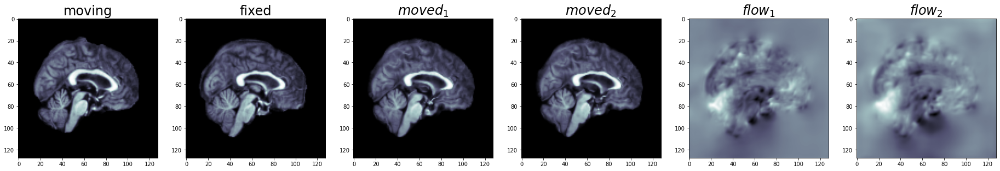

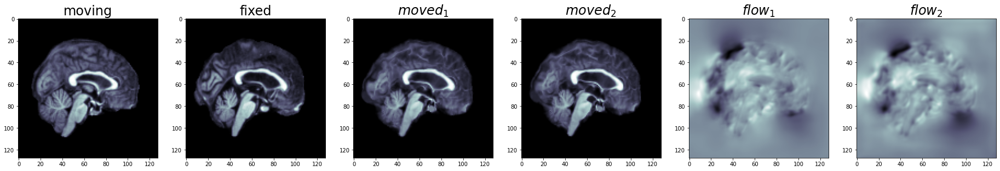

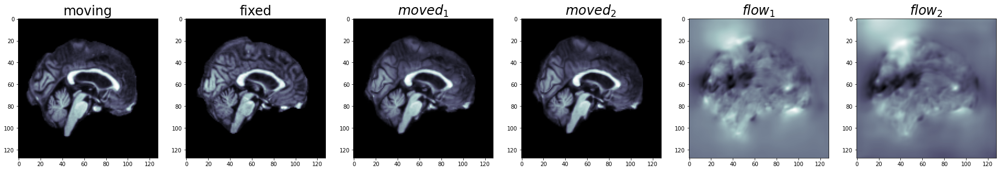

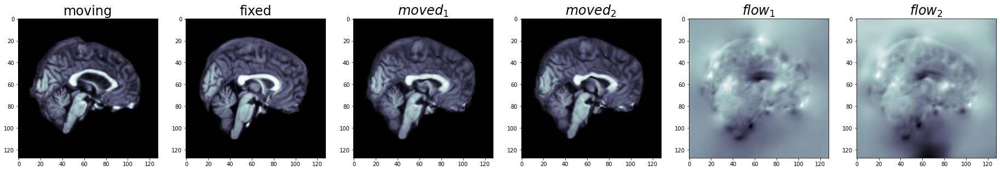

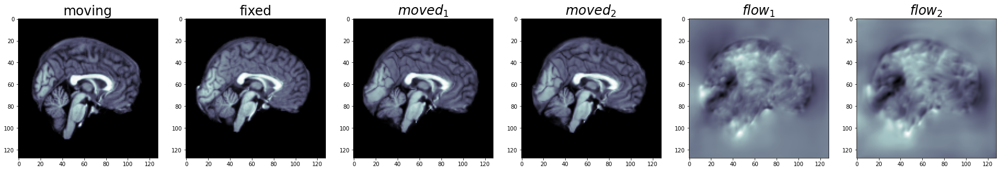

...

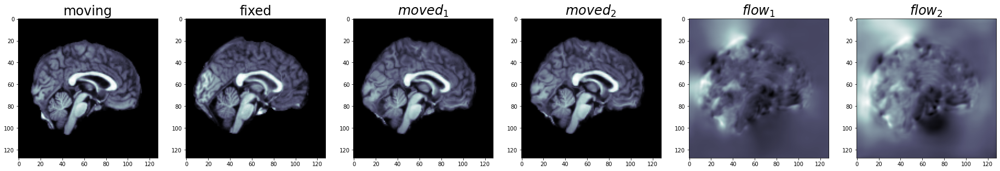

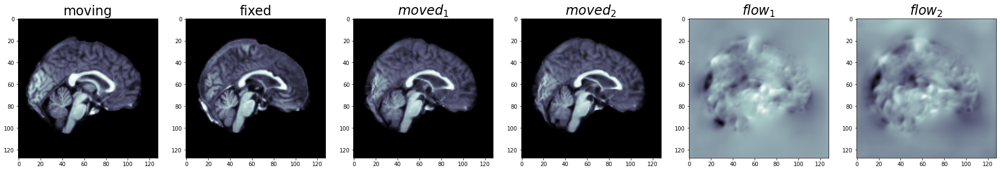

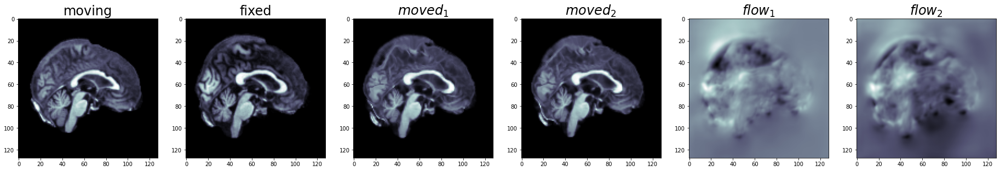

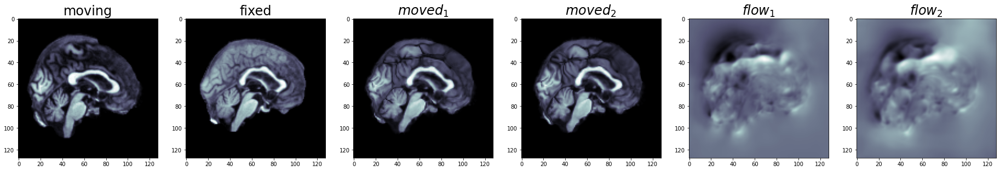

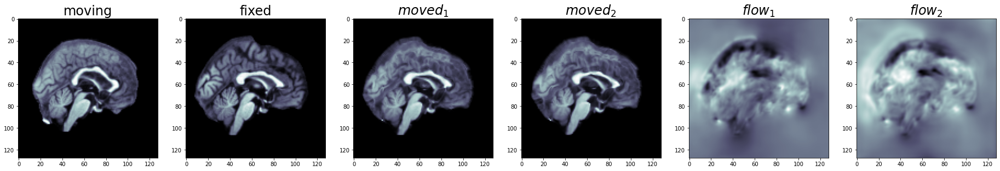

0.13578205415979028 0.13077146979048848


In [386]:
oasis_error1 = 0
oasis_error2 = 0
model1.eval()
model2.eval()
f = lambda x: x.detach().cpu().numpy()
for i, x in enumerate(oasis_test_dl):
    moved1, warp1 = model1(x.cuda())
    moved1, warp1 = map(f, (moved1, warp1))
    oasis_error1 += mse.loss(x[:, 0], moved1[:, 0]).item()
    moved2, warp2 = model2(x.cuda())
    moved2, warp2 = map(f, (moved2, warp2))
    oasis_error2 += mse.loss(x[:, 0], moved2[:, 0]).item()

    fontsize=24
    cmap=plt.cm.bone

    if i > 10: break
    moving, fixed = x[0, 0], x[0, 1]
    fig, ax = plt.subplots(nrows=1, ncols=4, figsize=(32, 16))
    ax[0].imshow(moving, cmap=cmap)
    ax[0].set_title(r'moving', fontsize=fontsize)
    ax[1].imshow(fixed, cmap=cmap)
    ax[1].set_title(r'fixed', fontsize=fontsize)
    ax[2].imshow(moved1[0, 0], cmap=cmap)
    ax[2].set_title(r'$moved_1$', fontsize=fontsize)
    ax[3].imshow(moved2[0, 0], cmap=cmap)
    ax[3].set_title(r'$moved_2$', fontsize=fontsize)
    flow1 = ax[4].imshow(warp1[0].sum(0), cmap=cmap)
    ax[4].set_title(r'$flow_1$', fontsize=fontsize)
    # fig.colorbar(flow1, ax=ax[3])
    flow2 = ax[5].imshow(warp2[0].sum(0), cmap=cmap)
    ax[5].set_title(r'$flow_2$', fontsize=fontsize)
    # fig.colorbar(flow2, ax=ax[5])
    # plt.savefig(f'figures/voxelmorph-domain-{k}-{str(i).zfill(4)}.png')
    plt.show()
    plt.close()

print(*map(np.mean, (oasis_error1, oasis_error2)))

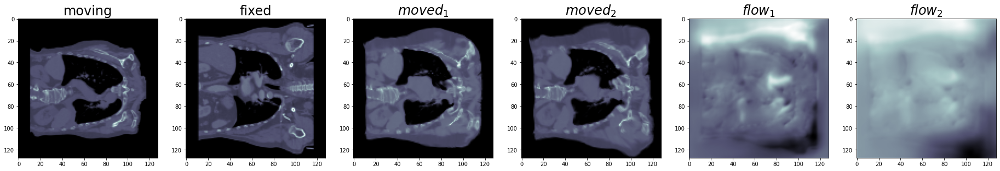

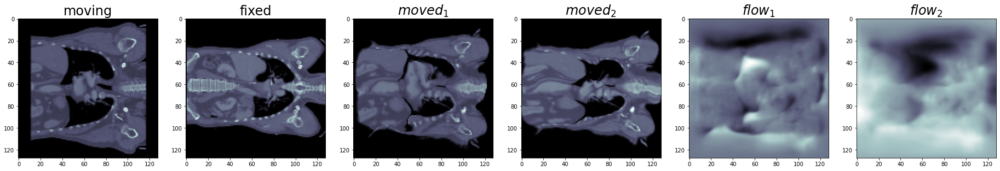

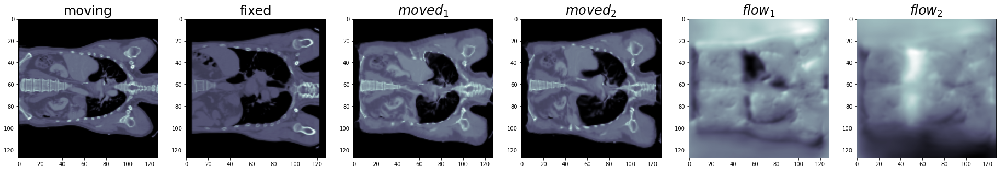

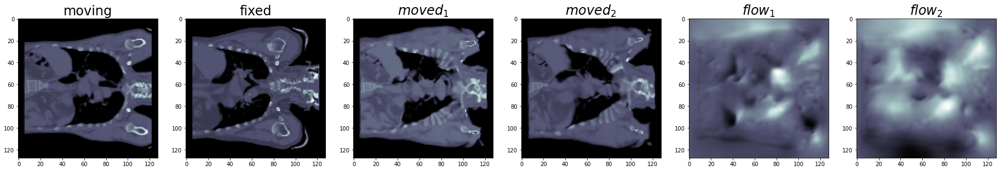

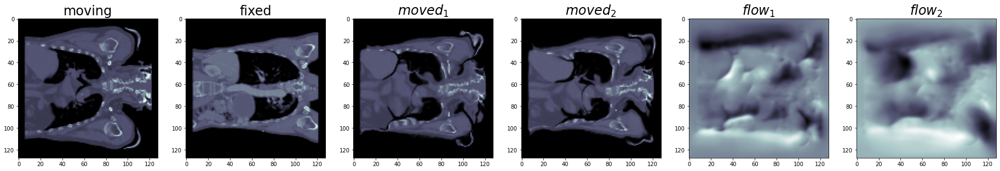

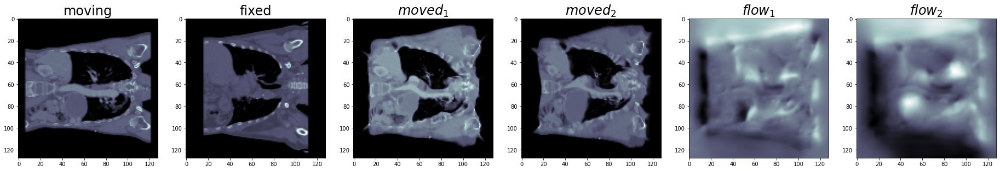

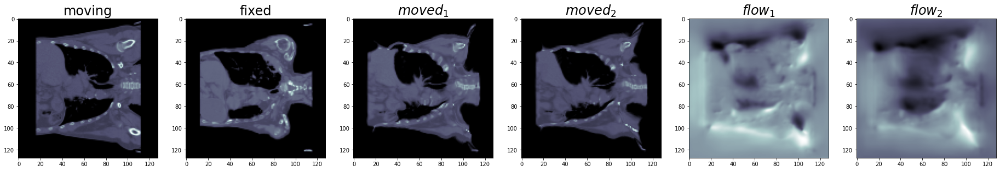

0.16241881251335144 0.20041142031550407


In [387]:
segthor_cor_error1 = 0
segthor_cor_error2 = 0
model1.eval()
model2.eval()
f = lambda x: x.detach().cpu().numpy()
for i, x in enumerate(segthor_cor_test_dl):
    moved1, warp1 = model1(x.cuda())
    moved1, warp1 = map(f, (moved1, warp1))
    segthor_cor_error1 += mse.loss(x[:, 0], moved1[:, 0]).item()
    moved2, warp2 = model2(x.cuda())
    moved2, warp2 = map(f, (moved2, warp2))
    segthor_cor_error2 += mse.loss(x[:, 0], moved2[:, 0]).item()

    fontsize=24
    cmap=plt.cm.bone

    if i > 10: break
    moving, fixed = x[0, 0], x[0, 1]
    fig, ax = plt.subplots(nrows=1, ncols=6, figsize=(32, 16))
    ax[0].imshow(moving, cmap=cmap)
    ax[0].set_title(r'moving', fontsize=fontsize)
    ax[1].imshow(fixed, cmap=cmap)
    ax[1].set_title(r'fixed', fontsize=fontsize)
    ax[2].imshow(moved1[0, 0], cmap=cmap)
    ax[2].set_title(r'$moved_1$', fontsize=fontsize)
    ax[3].imshow(moved2[0, 0], cmap=cmap)
    ax[3].set_title(r'$moved_2$', fontsize=fontsize)
    flow1 = ax[4].imshow(warp1[0].sum(0), cmap=cmap)
    ax[4].set_title(r'$flow_1$', fontsize=fontsize)
    # fig.colorbar(flow1, ax=ax[3])
    flow2 = ax[5].imshow(warp2[0].sum(0), cmap=cmap)
    ax[5].set_title(r'$flow_2$', fontsize=fontsize)
    # fig.colorbar(flow2, ax=ax[5])
    # plt.savefig(f'figures/voxelmorph-domain-{k}-{str(i).zfill(4)}.png')
    plt.show()
    plt.close()

print(*map(np.mean, (segthor_cor_error1, segthor_cor_error2)))

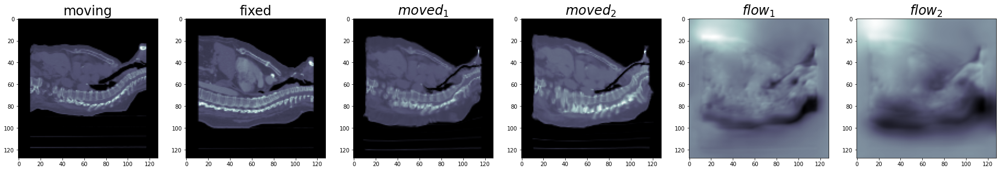

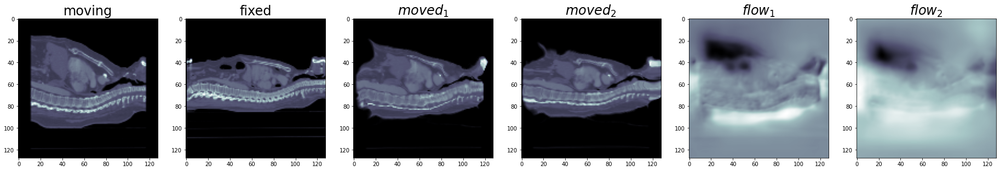

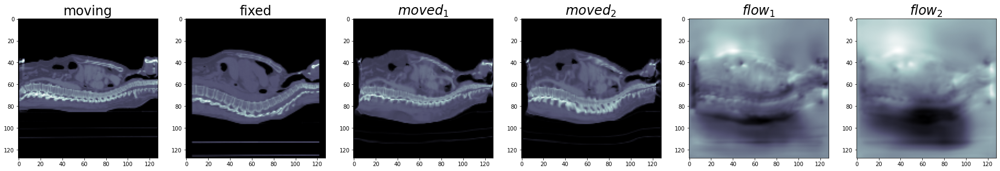

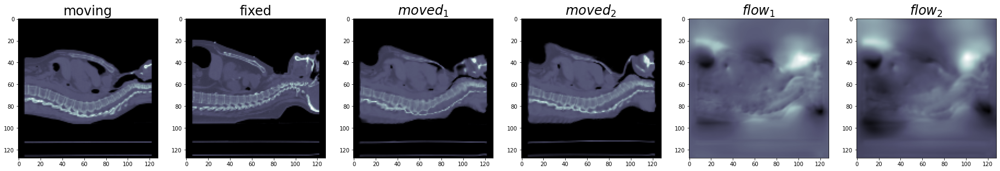

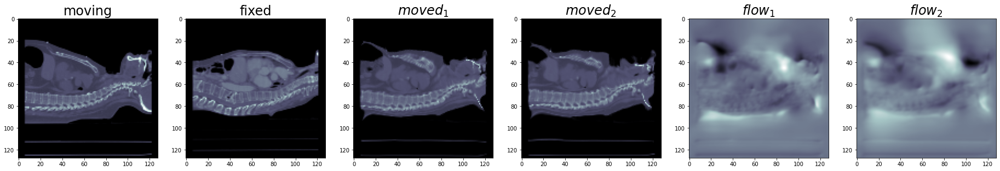

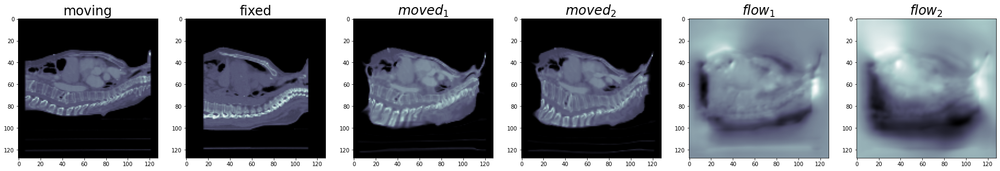

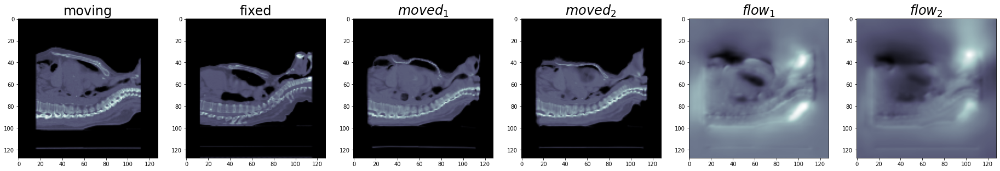

0.09783350210636854 0.12419447395950556


In [388]:
segthor_sag_error1 = 0
segthor_sag_error2 = 0
model1.eval()
model2.eval()
f = lambda x: x.detach().cpu().numpy()
for i, x in enumerate(segthor_sag_test_dl):
    moved1, warp1 = model1(x.cuda())
    moved1, warp1 = map(f, (moved1, warp1))
    segthor_sag_error1 += mse.loss(x[:, 0], moved1[:, 0]).item()
    moved2, warp2 = model2(x.cuda())
    moved2, warp2 = map(f, (moved2, warp2))
    segthor_sag_error2 += mse.loss(x[:, 0], moved2[:, 0]).item()

    fontsize=24
    cmap=plt.cm.bone

    if i > 10: break
    moving, fixed = x[0, 0], x[0, 1]
    fig, ax = plt.subplots(nrows=1, ncols=6, figsize=(32, 16))
    ax[0].imshow(moving, cmap=cmap)
    ax[0].set_title(r'moving', fontsize=fontsize)
    ax[1].imshow(fixed, cmap=cmap)
    ax[1].set_title(r'fixed', fontsize=fontsize)
    ax[2].imshow(moved1[0, 0], cmap=cmap)
    ax[2].set_title(r'$moved_1$', fontsize=fontsize)
    ax[3].imshow(moved2[0, 0], cmap=cmap)
    ax[3].set_title(r'$moved_2$', fontsize=fontsize)
    flow1 = ax[4].imshow(warp1[0].sum(0), cmap=cmap)
    ax[4].set_title(r'$flow_1$', fontsize=fontsize)
    # fig.colorbar(flow1, ax=ax[3])
    flow2 = ax[5].imshow(warp2[0].sum(0), cmap=cmap)
    ax[5].set_title(r'$flow_2$', fontsize=fontsize)
    # fig.colorbar(flow2, ax=ax[5])
    # plt.savefig(f'figures/voxelmorph-domain-{k}-{str(i).zfill(4)}.png')
    plt.show()
    plt.close()

print(*map(np.mean, (segthor_sag_error1, segthor_sag_error2)))

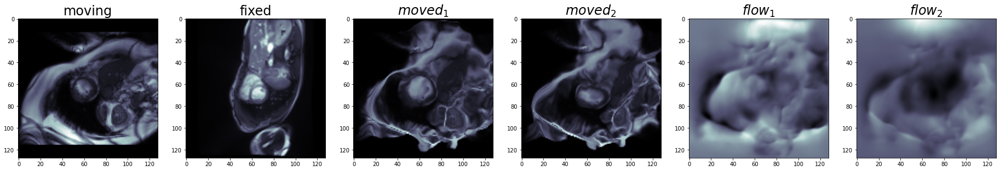

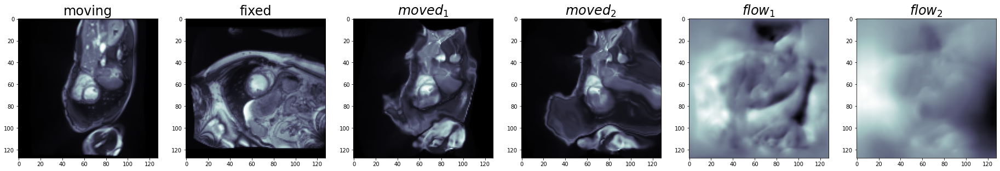

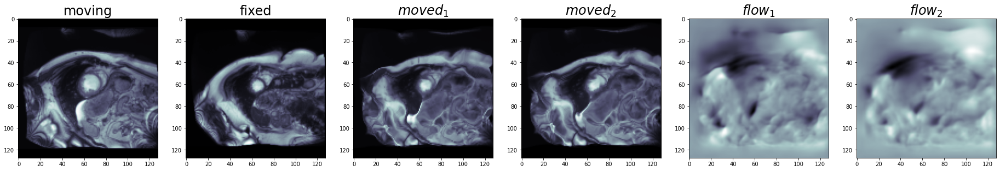

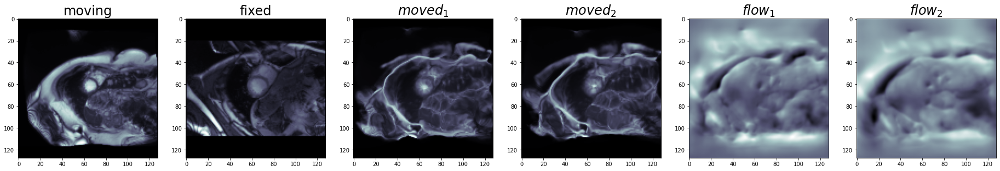

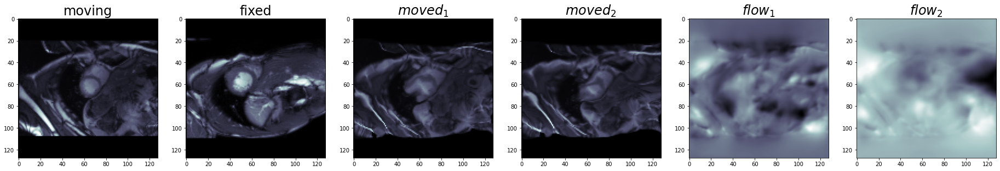

...

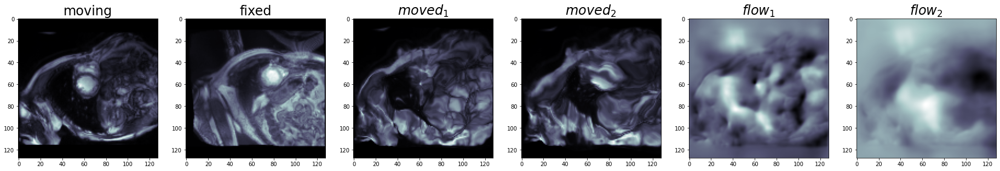

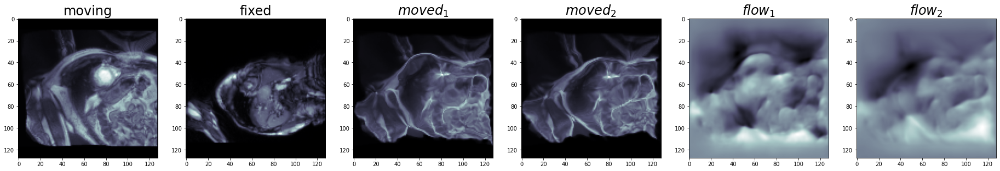

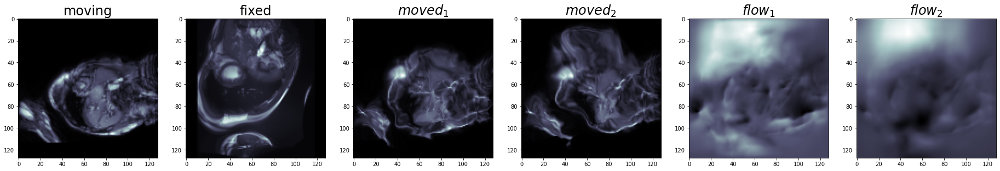

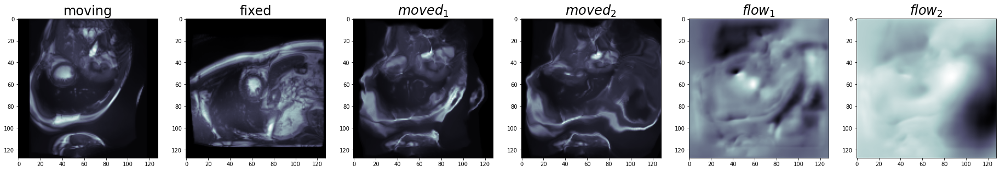

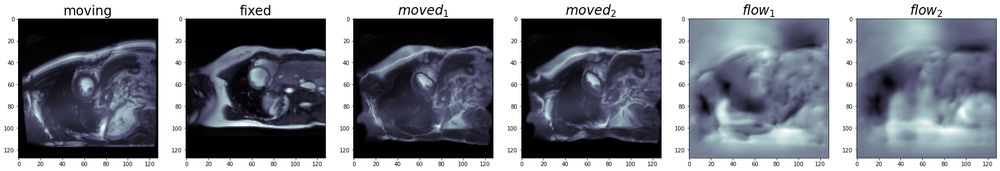

0.2569853812456131 0.30592020228505135


In [389]:
acdc_error1 = 0
acdc_error2 = 0
model1.eval()
model2.eval()
f = lambda x: x.detach().cpu().numpy()
for i, x in enumerate(acdc_test_dl):
    moved1, warp1 = model1(x.cuda())
    moved1, warp1 = map(f, (moved1, warp1))
    acdc_error1 += mse.loss(x[:, 0], moved1[:, 0]).item()
    moved2, warp2 = model2(x.cuda())
    moved2, warp2 = map(f, (moved2, warp2))
    acdc_error2 += mse.loss(x[:, 0], moved2[:, 0]).item()

    fontsize=24
    cmap=plt.cm.bone

    if i > 10: break
    moving, fixed = x[0, 0], x[0, 1]
    fig, ax = plt.subplots(nrows=1, ncols=6, figsize=(32, 16))
    ax[0].imshow(moving, cmap=cmap)
    ax[0].set_title(r'moving', fontsize=fontsize)
    ax[1].imshow(fixed, cmap=cmap)
    ax[1].set_title(r'fixed', fontsize=fontsize)
    ax[2].imshow(moved1[0, 0], cmap=cmap)
    ax[2].set_title(r'$moved_1$', fontsize=fontsize)
    ax[3].imshow(moved2[0, 0], cmap=cmap)
    ax[3].set_title(r'$moved_2$', fontsize=fontsize)
    flow1 = ax[4].imshow(warp1[0].sum(0), cmap=cmap)
    ax[4].set_title(r'$flow_1$', fontsize=fontsize)
    # fig.colorbar(flow1, ax=ax[3])
    flow2 = ax[5].imshow(warp2[0].sum(0), cmap=cmap)
    ax[5].set_title(r'$flow_2$', fontsize=fontsize)
    # fig.colorbar(flow2, ax=ax[5])
    # plt.savefig(f'figures/voxelmorph-domain-{k}-{str(i).zfill(4)}.png')
    plt.show()
    plt.close()

print(*map(np.mean, (acdc_error1, acdc_error2)))

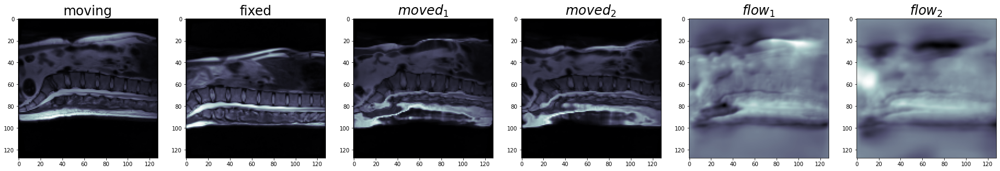

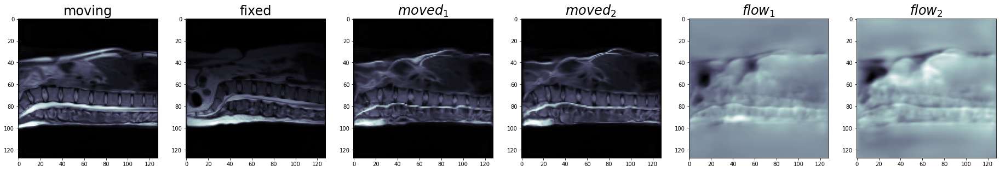

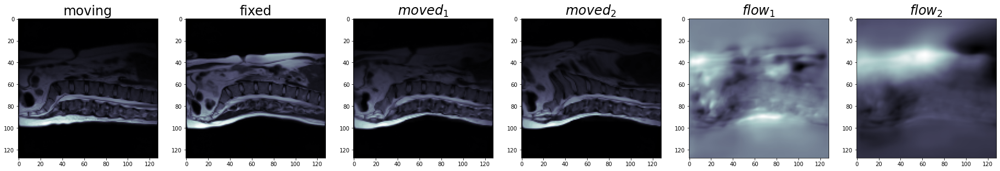

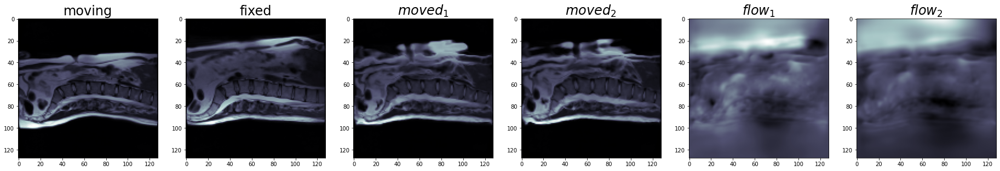

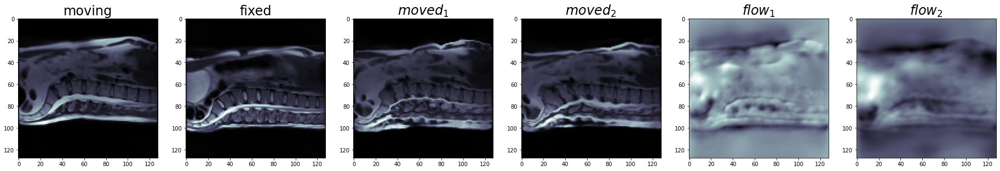

...

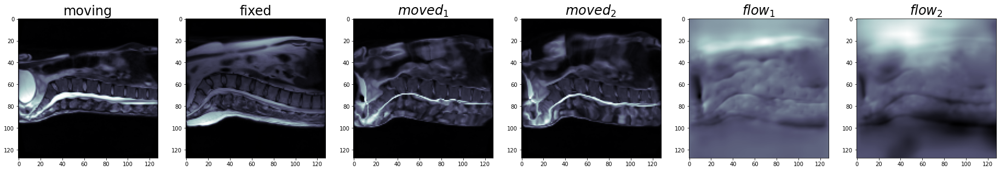

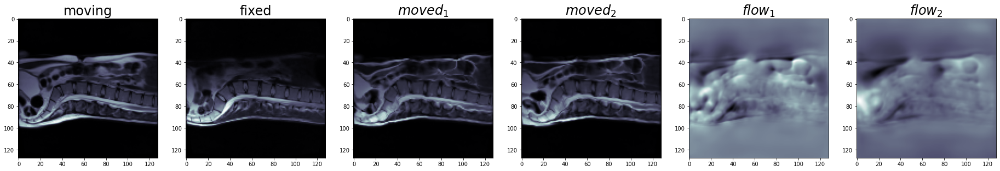

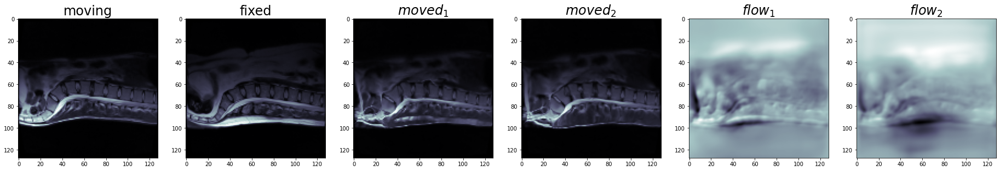

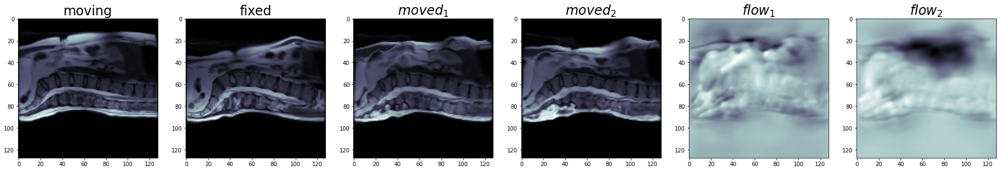

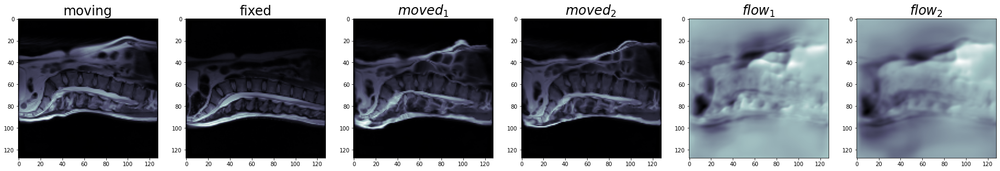

0.25074877217411995 0.26742805540561676


In [390]:
spineweb_error1 = 0
spineweb_error2 = 0
model1.eval()
model2.eval()
f = lambda x: x.detach().cpu().numpy()
for dl in (spineweb_train_dl, spineweb_val_dl, spineweb_test_dl):
    for i, x in enumerate(dl):
        moved1, warp1 = model1(x.cuda())
        moved1, warp1 = map(f, (moved1, warp1))
        spineweb_error1 += mse.loss(x[:, 0], moved1[:, 0]).item()
        moved2, warp2 = model2(x.cuda())
        moved2, warp2 = map(f, (moved2, warp2))
        spineweb_error2 += mse.loss(x[:, 0], moved2[:, 0]).item()

        fontsize=24
        cmap=plt.cm.bone

        if i > 10: break
        moving, fixed = x[0, 0], x[0, 1]
        fig, ax = plt.subplots(nrows=1, ncols=6, figsize=(32, 16))
        ax[0].imshow(moving, cmap=cmap)
        ax[0].set_title(r'moving', fontsize=fontsize)
        ax[1].imshow(fixed, cmap=cmap)
        ax[1].set_title(r'fixed', fontsize=fontsize)
        ax[2].imshow(moved1[0, 0], cmap=cmap)
        ax[2].set_title(r'$moved_1$', fontsize=fontsize)
        ax[3].imshow(moved2[0, 0], cmap=cmap)
        ax[3].set_title(r'$moved_2$', fontsize=fontsize)
        flow1 = ax[4].imshow(warp1[0].sum(0), cmap=cmap)
        ax[4].set_title(r'$flow_1$', fontsize=fontsize)
        # fig.colorbar(flow1, ax=ax[3])
        flow2 = ax[5].imshow(warp2[0].sum(0), cmap=cmap)
        ax[5].set_title(r'$flow_2$', fontsize=fontsize)
        # fig.colorbar(flow2, ax=ax[5])
        # plt.savefig(f'figures/voxelmorph-domain-{k}-{str(i).zfill(4)}.png')
        plt.show()
        plt.close()

print(*map(np.mean, (spineweb_error1, spineweb_error2)))

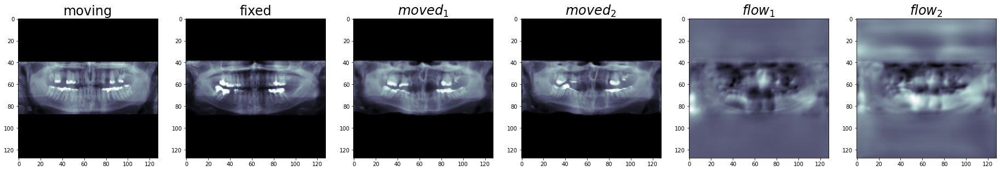

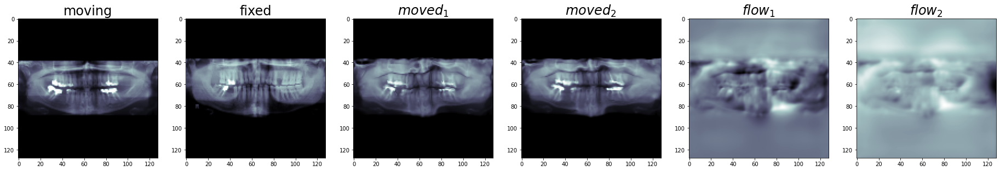

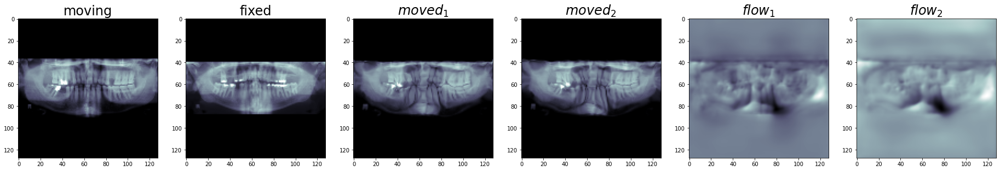

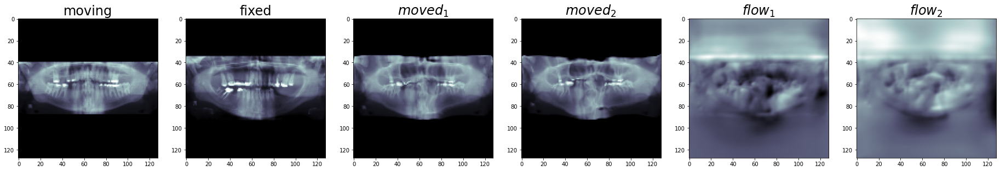

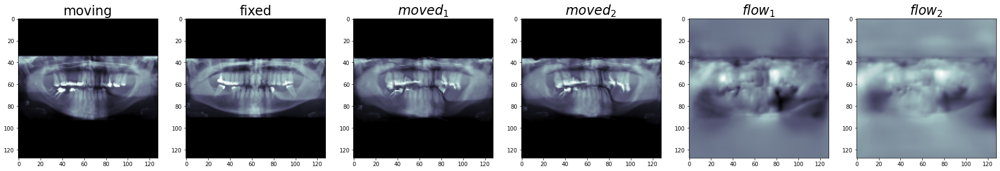

...

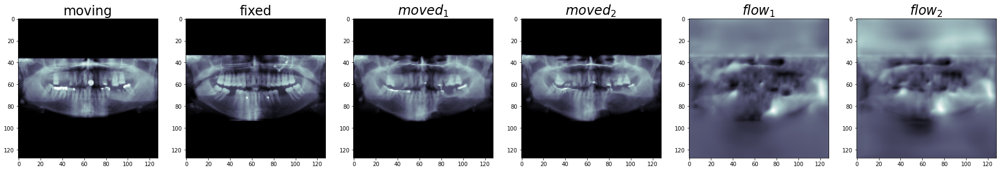

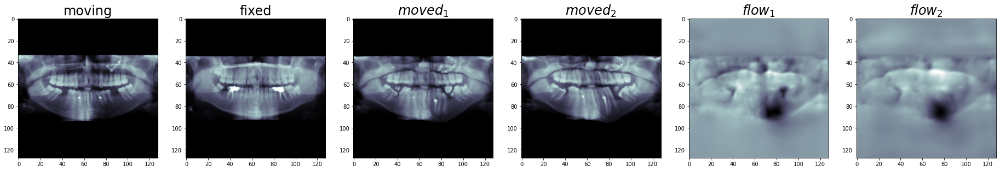

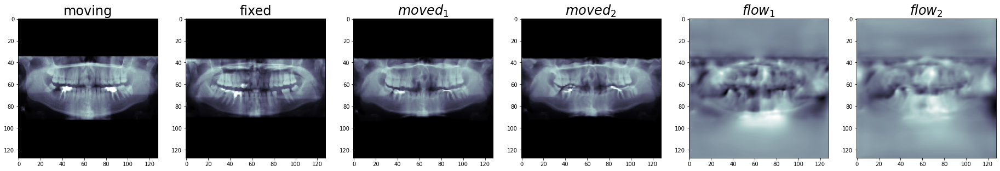

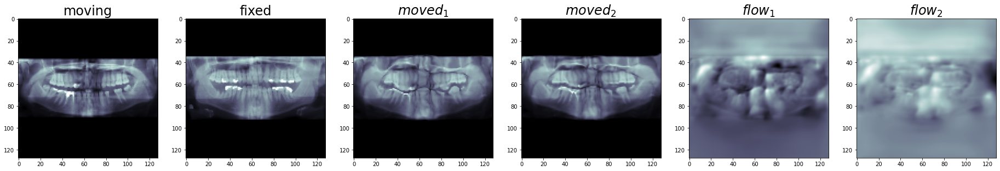

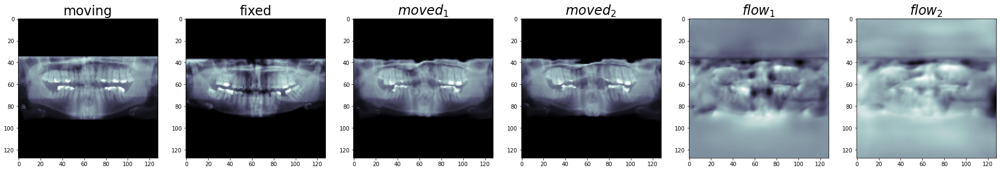

0.37083053635433316 0.3655751943588257


In [391]:
pandental_error1 = 0
pandental_error2 = 0
model1.eval()
model2.eval()
f = lambda x: x.detach().cpu().numpy()
for dl in (pandental_train_dl, pandental_val_dl, pandental_test_dl):
    for i, x in enumerate(dl):
        moved1, warp1 = model1(x.cuda())
        moved1, warp1 = map(f, (moved1, warp1))
        pandental_error1 += mse.loss(x[:, 0], moved1[:, 0]).item()
        moved2, warp2 = model2(x.cuda())
        moved2, warp2 = map(f, (moved2, warp2))
        pandental_error2 += mse.loss(x[:, 0], moved2[:, 0]).item()

        fontsize=24
        cmap=plt.cm.bone

        if i > 10: break
        moving, fixed = x[0, 0], x[0, 1]
        fig, ax = plt.subplots(nrows=1, ncols=6, figsize=(32, 16))
        ax[0].imshow(moving, cmap=cmap)
        ax[0].set_title(r'moving', fontsize=fontsize)
        ax[1].imshow(fixed, cmap=cmap)
        ax[1].set_title(r'fixed', fontsize=fontsize)
        ax[2].imshow(moved1[0, 0], cmap=cmap)
        ax[2].set_title(r'$moved_1$', fontsize=fontsize)
        ax[3].imshow(moved2[0, 0], cmap=cmap)
        ax[3].set_title(r'$moved_2$', fontsize=fontsize)
        flow1 = ax[4].imshow(warp1[0].sum(0), cmap=cmap)
        ax[4].set_title(r'$flow_1$', fontsize=fontsize)
        # fig.colorbar(flow1, ax=ax[3])
        flow2 = ax[5].imshow(warp2[0].sum(0), cmap=cmap)
        ax[5].set_title(r'$flow_2$', fontsize=fontsize)
        # fig.colorbar(flow2, ax=ax[5])
        # plt.savefig(f'figures/voxelmorph-domain-{k}-{str(i).zfill(4)}.png')
        plt.show()
        plt.close()
        
print(*map(np.mean, (pandental_error1, pandental_error2)))